In [4]:
import sys

sys.path.append("c:\\Users\\robin\\Documents\\HyperBrain")
sys.path.append("c:\\Users\\robin\\Documents\\HyperBrain\\source")

In [14]:
import torch
from kornia.geometry.transform import warp_perspective
from source.data_processing.image_reading import read_image
from source.data_processing.keypoints import generate_image_grid_coordinates
from source.data_processing.transformations import transform_grid_coordinates, sample_random_perspective_matrix
import numpy as np
import matplotlib.pyplot as plt
from source.data_processing.cropping import _get_transformed_image_corner_positions, _calculate_crop_area_bounds

In [11]:
image_1 = read_image("../../data/cyto_downscaled_3344_3904/B20_0429_Slice15_transformed.tif")
image_1 = torch.Tensor(np.array(image_1))
image_2 = read_image("../../data/cyto_downscaled_3344_3904/B20_0430_Slice15_transformed.tif")
image_2 = torch.Tensor(np.array(image_2))
grid_coordinates = generate_image_grid_coordinates(image_size=image_2.shape)

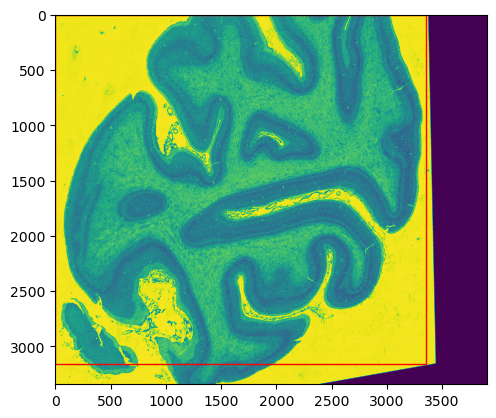

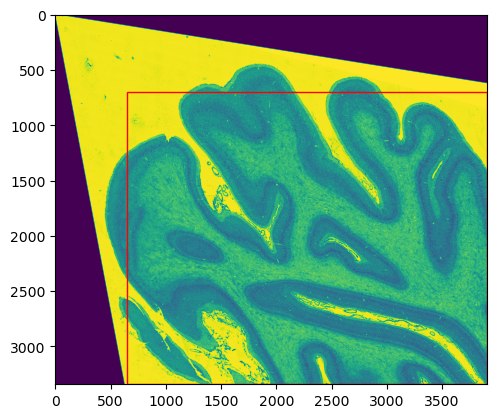

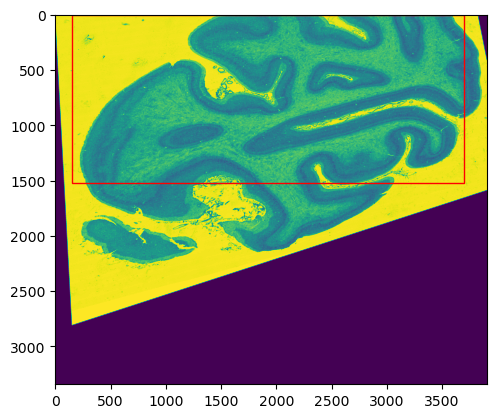

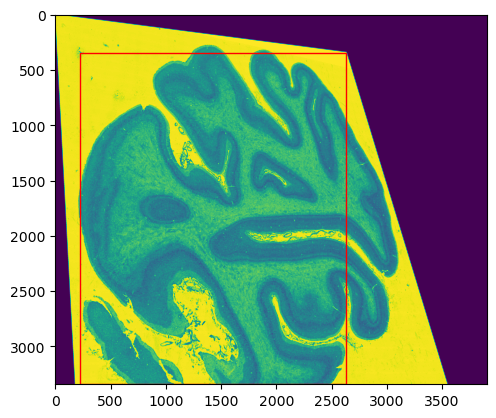

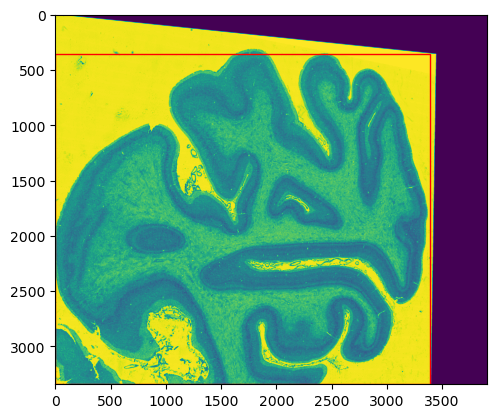

...

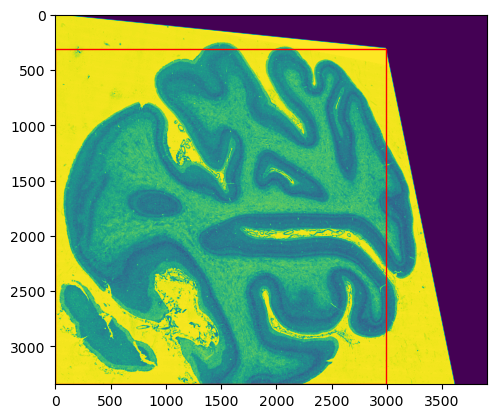

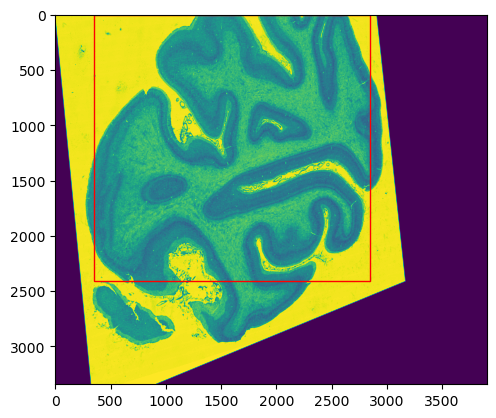

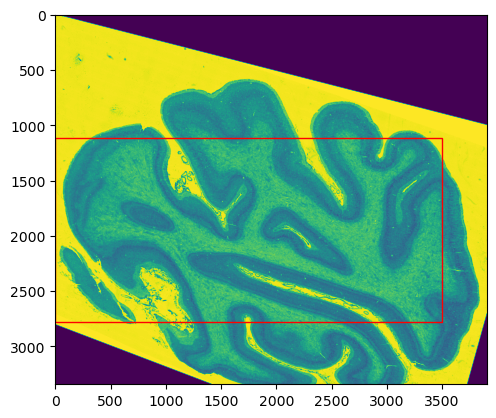

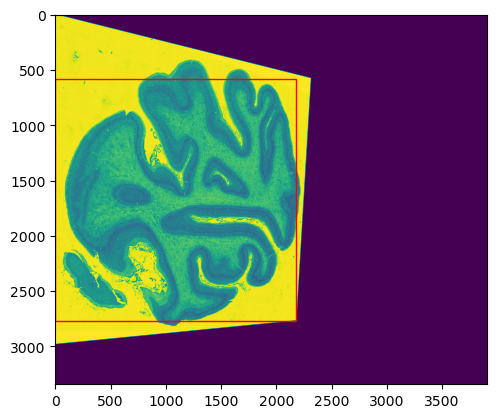

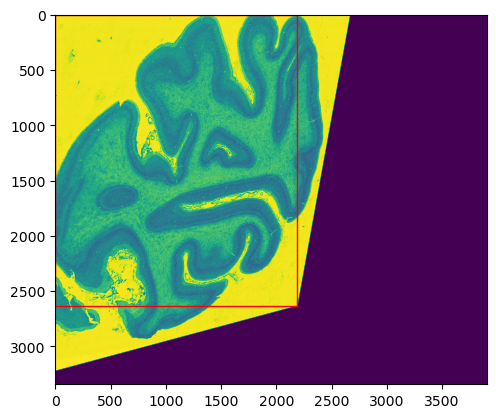

In [21]:
import matplotlib.patches as patches

for _ in range(100):
    transformation_matrix = sample_random_perspective_matrix(range_limit_affine=0.25, range_limit_perspective=0.0001)
    image_2_transformed = warp_perspective(
            src=image_2.unsqueeze(0).unsqueeze(0),
            M=transformation_matrix,
            dsize=image_2.shape,
            mode="nearest",
        )[0]
    image_coordinate_mapping = transform_grid_coordinates(
            grid_coordinates=grid_coordinates,
            transformation_matrix=transformation_matrix[0],
        )
    
    (top_left,
    top_right,
    bottom_left,
    bottom_right,
    ) = _get_transformed_image_corner_positions(image_coordinate_mapping)
    
    (
        crop_position_min_x,
        crop_position_max_x,
        crop_position_min_y,
        crop_position_max_y,
    ) = _calculate_crop_area_bounds(
        top_left, top_right, bottom_left, bottom_right, image_2.shape
    )

    plt.imshow(image_2_transformed[0])
    
    # Add rectangle
    rect = patches.Rectangle(
        (crop_position_min_x, crop_position_min_y),
        crop_position_max_x - crop_position_min_x,
        crop_position_max_y - crop_position_min_y,
        linewidth=1,
        edgecolor='r',
        facecolor='none'
    )
    plt.gca().add_patch(rect)
    plt.show()

